In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from dataprep.eda import create_report
from pandas_profiling import ProfileReport
from sklearn.compose import (
    ColumnTransformer,
    TransformedTargetRegressor,
    make_column_transformer,
)
from sklearn.dummy import DummyRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.impute import SimpleImputer
from sklearn.linear_model import Ridge, RidgeCV
from sklearn.metrics import make_scorer, mean_squared_error, r2_score
from sklearn.model_selection import (
    GridSearchCV,
    cross_val_score,
    cross_validate,
    train_test_split,
)
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.tree import DecisionTreeRegressor
%matplotlib inline

Pandas backend loaded 1.4.3
Numpy backend loaded 1.23.2
Pyspark backend NOT loaded
Python backend loaded
C:\Users\Nandakumar\AppData\Local\Temp\ipykernel_5812\3904670446.py:5: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [2]:
import warnings

warnings.simplefilter(action="ignore", category=FutureWarning)

In [3]:
data=pd.read_csv('query_result.csv')

# Exploratory Data Analysis

In [4]:
profile = ProfileReport(data, title="Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Key findings:
- columns named **lp_dol** has high correlation with our target variable
- **yr_built** and **garage type** has some missing values which is less than 1% of the total dataset ( missing in random category)
- lat and lon does not have direct correlation between the target column (location might not be a huge factor as of now but lets dig deeper while making them a categorical feature and checking later.)
- We can see that id_community,id_municipality,ml_num are ids we have to cast it as objects so that they dont add in the Modelling  part.
- ml_num should not be considered in the future of modelling because it has all distinct values and hence making model more ambiguous.

#### The date column can be really helpful in upcoming  predictions so converted into the right format

In [6]:
data['date_start'] = pd.to_datetime(data['date_start'], format='%Y-%m-%d %H:%M:%S')
data['date_end'] = pd.to_datetime(data['date_end'], format='%Y-%m-%d %H:%M:%S')
data['diff_in_dates'] =pd.to_numeric(data['date_end']-  data ['date_start'])
data['id_municipality'] =data['id_municipality'].astype(object)
data['id_community'] =data['id_community'].astype(object)

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 136119 entries, 0 to 136118
Data columns (total 25 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   ml_num                   136119 non-null  object        
 1   property_type            136119 non-null  object        
 2   br                       134949 non-null  float64       
 3   br_plus                  136119 non-null  int64         
 4   br_final                 136119 non-null  float64       
 5   bath_tot                 136119 non-null  int64         
 6   taxes                    136119 non-null  float64       
 7   lp_dol                   136119 non-null  int64         
 8   yr_built                 136117 non-null  object        
 9   gar_type                 134343 non-null  object        
 10  garage                   136119 non-null  float64       
 11  topHighschoolScore       136119 non-null  float64       
 12  topBelowHighscho

In [8]:
# splitting the data to maintain the golden rule
from sklearn.model_selection import cross_val_score, cross_validate, train_test_split
train_df,test_df = train_test_split(data,test_size=0.2 ,random_state=123)
train_df.shape

(108895, 25)

In [10]:
#huge variability in the data these are allshould be moslty closely located area in a location. 
data['geo_latitude'].value_counts(normalize=True)

43.777502    0.000984
43.641579    0.000771
43.641596    0.000676
43.659329    0.000669
43.636101    0.000654
               ...   
44.403672    0.000007
43.818745    0.000007
43.701665    0.000007
43.396994    0.000007
43.894330    0.000007
Name: geo_latitude, Length: 98896, dtype: float64

In [11]:
train_df.describe().T

,count,mean,std,min,25%,50%,75%,max
br,107964.0,2.901078e+00,1.048421e+00,0.000000,2.000000e+00,3.000000e+00,4.000000e+00,9.000000e+00
br_plus,108895.0,5.094816e-01,7.061903e-01,0.000000,0.000000e+00,0.000000e+00,1.000000e+00,9.000000e+00
br_final,108895.0,2.964327e+00,1.042934e+00,0.000000,2.100000e+00,3.000000e+00,4.000000e+00,9.900000e+00
bath_tot,108895.0,2.630562e+00,1.207713e+00,0.000000,2.000000e+00,2.000000e+00,3.000000e+00,1.800000e+01
taxes,108895.0,3.781379e+03,6.478388e+03,0.000000,2.425000e+03,3.375250e+03,4.486395e+03,8.852670e+05
lp_dol,108895.0,6.735559e+05,5.135342e+05,1.000000,3.890000e+05,5.499000e+05,7.890000e+05,2.680000e+07
garage,108895.0,1.270563e+00,1.497978e+00,0.000000,1.000000e+00,1.000000e+00,2.000000e+00,3.300000e+02
topHighschoolScore,108895.0,4.352461e+00,3.189895e+00,0.000000,8.000000e-01,5.200000e+00,7.000000e+00,9.900000e+00
topBelowHighschoolScore,108895.0,5.651880e+00,2.137176e+00,0.000000,4.400000e+00,5.500000e+00,7.300000e+00,1.000000e+01
geo_latitude,108895.0,4.379830e+01,5.264347e-01,-41.872312,4.364237e+01,4.375466e+01,4.389240e+01,5.524626e+01


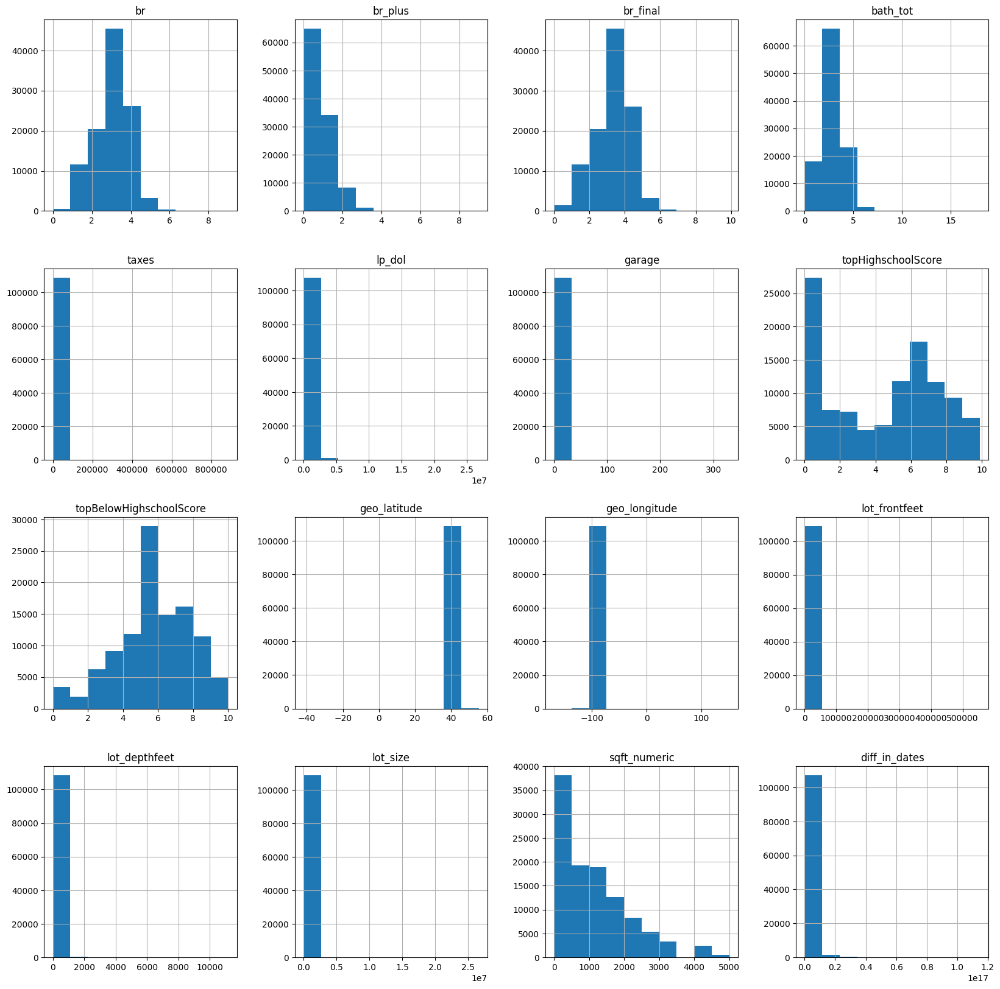

In [12]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
numeric_data=train_df[['br','br_plus', 'br_final',
                       'bath_tot', 'taxes', 
                       'lp_dol', 'garage', 'topHighschoolScore',
                       'topBelowHighschoolScore', 'geo_latitude',
                       'geo_longitude', 'lot_frontfeet', 'lot_depthfeet','lot_size','sqft_numeric','diff_in_dates']]
numeric_data.hist(figsize=(20,20));

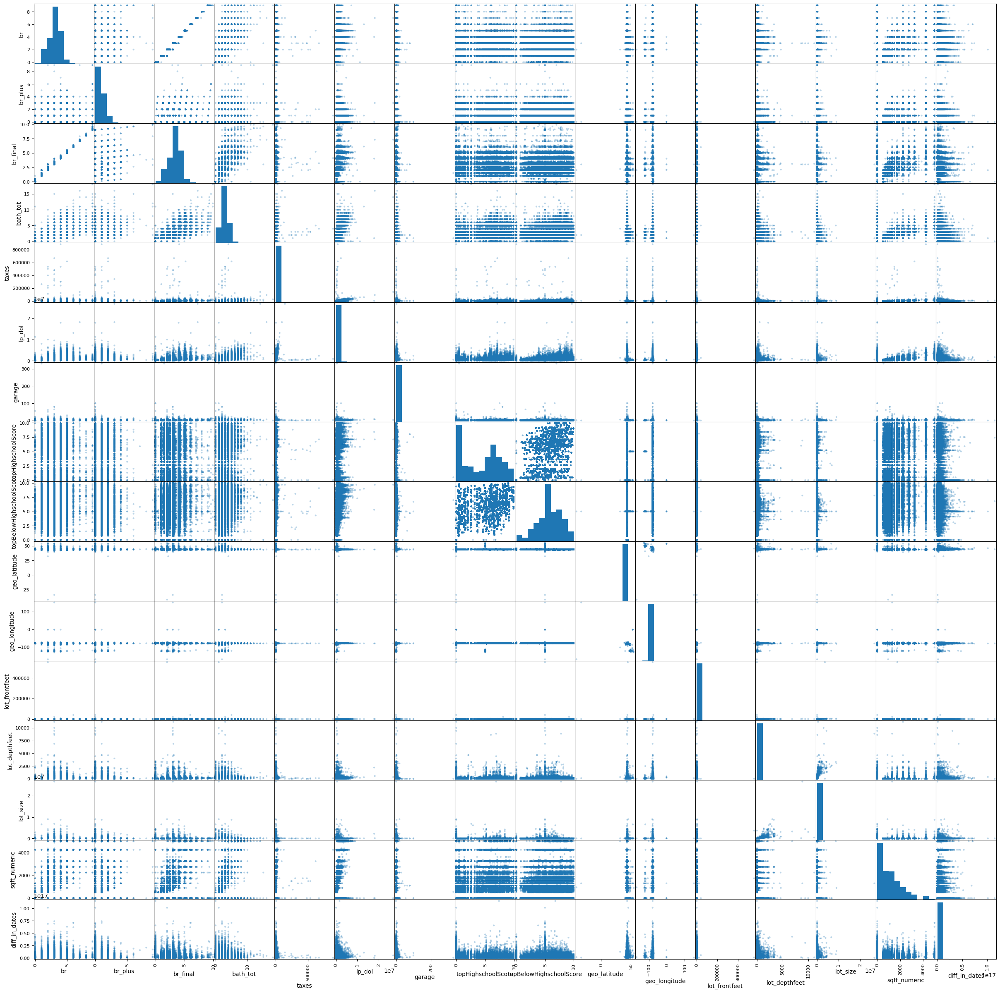

In [13]:
# we can see some correlated and some completely not corelated pattern here.
pd.plotting.scatter_matrix(numeric_data,alpha=.3,figsize=(30,30));

In [14]:
#getting all the categorical data seperately as they have to be trated diffierently 
categorical_df=train_df.select_dtypes(include='object').columns
categorical_df

Index(['ml_num', 'property_type', 'yr_built', 'gar_type', 'id_community',
       'id_municipality'],
      dtype='object')

In [15]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler

In [16]:
# there is one ordinal feature here year built as it has an inherent order to it 
list(train_df['yr_built'].unique())

['6-15',
 '0',
 '16-30',
 '0-5',
 'New',
 '31-50',
 '11-15',
 '100+',
 '51-99',
 '6-10',
 nan]

In [17]:
len(train_df['id_community'].unique())+len(train_df['property_type'].unique())+len(train_df['id_municipality'].unique())+len(train_df['gar_type'].unique())

1658

In [18]:
# as we can see below New ,0,0-5,6-15 ... up to 100+ lets create an order to it.
ordinal_feature_ordering =[
     ['New','0','0-5','6-10','6-15','11-15','16-30','31-50','51-99','100+','nan']]
ordinal_features_oth = ['yr_built']
#re-initializing removing year built
categorical_features= ['property_type', 'gar_type', 'id_community',
       'id_municipality']
# as this is id it can be dropped in the preparation step
drop_features = ['ml_num']
numeric_features = ['br','br_plus', 'br_final',
                       'bath_tot', 'taxes', 
                       'lp_dol', 'garage', 'topHighschoolScore',
                       'topBelowHighschoolScore', 'geo_latitude',
                       'geo_longitude', 'lot_frontfeet', 'lot_depthfeet','lot_size','sqft_numeric','diff_in_dates']
# creating pipeline so that the same process is releated in the test and dev as well 
numeric_transformer = make_pipeline(SimpleImputer(strategy="median"), StandardScaler())
ordinal_transformer_oth = make_pipeline(
    SimpleImputer(strategy="most_frequent"),
    OrdinalEncoder(categories=ordinal_feature_ordering),
)
categorical_transformer = make_pipeline(
    SimpleImputer(strategy="constant", fill_value="missing"),
    OneHotEncoder(handle_unknown="ignore", sparse=False),
)


In [24]:
X_train = train_df.drop(columns=['price_sold'])
X_test = test_df.drop(columns=['price_sold'])
y_train = train_df['price_sold']
y_test = test_df['price_sold']

In [19]:
#preprocessor defined to handle all types of data
preprocessor = make_column_transformer(
    ("drop", drop_features),
    (numeric_transformer, numeric_features),
    (ordinal_transformer_oth, ordinal_features_oth),
    (categorical_transformer, categorical_features),
)

In [20]:
preprocessor

ColumnTransformer(transformers=[('drop', 'drop', ['ml_num']),
                                ('pipeline-1',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('standardscaler',
                                                  StandardScaler())]),
                                 ['br', 'br_plus', 'br_final', 'bath_tot',
                                  'taxes', 'lp_dol', 'garage',
                                  'topHighschoolScore',
                                  'topBelowHighschoolScore', 'geo_latitude',
                                  'geo_longitude', 'lot_frontfeet',
                                  'lot_depthfeet...
                                                  OrdinalEncoder(categories=[['New',
                                                                              '0',
                                         

In [21]:
preprocessor.fit(X_train)  # Calling fit to examine all the transformers.
preprocessor.named_transformers_

{'drop': 'drop',
 'pipeline-1': Pipeline(steps=[('simpleimputer', SimpleImputer(strategy='median')),
                 ('standardscaler', StandardScaler())]),
 'pipeline-2': Pipeline(steps=[('simpleimputer', SimpleImputer(strategy='most_frequent')),
                 ('ordinalencoder',
                  OrdinalEncoder(categories=[['New', '0', '0-5', '6-10', '6-15',
                                              '11-15', '16-30', '31-50', '51-99',
                                              '100+', 'nan']]))]),
 'pipeline-3': Pipeline(steps=[('simpleimputer',
                  SimpleImputer(fill_value='missing', strategy='constant')),
                 ('onehotencoder',
                  OneHotEncoder(handle_unknown='ignore', sparse=False))]),
 'remainder': 'drop'}

In [22]:
ohe_columns = list(
    preprocessor.named_transformers_["pipeline-3"]
    .named_steps["onehotencoder"]
    .get_feature_names_out(categorical_features)
)
new_columns = (
    numeric_features  + ordinal_features_oth + ohe_columns
)

In [23]:
X_train_enc = pd.DataFrame(
    preprocessor.transform(X_train), index=X_train.index, columns=new_columns
)
X_train_enc.head()

,br,br_plus,br_final,bath_tot,taxes,lp_dol,garage,topHighschoolScore,topBelowHighschoolScore,geo_latitude,...,id_municipality_12922,id_municipality_12923,id_municipality_12936,id_municipality_12939,id_municipality_12943,id_municipality_12956,id_municipality_12958,id_municipality_12961,id_municipality_12962,id_municipality_12965
32534,1.051833,-0.721454,0.993042,1.133916,0.089617,-0.182376,0.486950,-1.364459,-0.305021,1.075870,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51293,-0.863941,-0.721454,-0.924633,-0.522115,-0.172718,-0.456751,-0.180620,-1.207713,-1.428003,-0.263046,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
59241,-0.863941,0.694601,-0.445214,0.305901,-0.112186,0.051300,1.822089,0.986726,1.473035,-0.310424,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50702,-1.821828,0.694601,-1.404052,-1.350130,-0.210964,-0.591504,-0.180620,0.704584,0.911543,-0.058526,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
37089,-0.863941,0.694601,-0.828749,-1.350130,-0.027998,-0.454998,-0.180620,-0.110493,0.303261,0.107421,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [25]:
X_train.shape , X_train_enc.shape
# there is jump of 1651 features

((108895, 24), (108895, 1675))

# Model Building
1. Three machine learning models such as,
    * Regression based on k-nearest neighbors.
    * Ridge: Linear least squares with l2 regularization.
    * Random Forest Regressor: To improve score and avoid over-fitting.

In [30]:
from sklearn.linear_model import Ridge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
models = {
    "KNN_reg": KNeighborsRegressor(),
    "Ridge": Ridge(),
    "RandomForest" : RandomForestRegressor()
}
score_types_reg = {
    "neg_mean_squared_error": "neg_mean_squared_error",
    "neg_root_mean_squared_error": "neg_root_mean_squared_error",
    "neg_mape": "neg_mean_absolute_percentage_error", 
    "r2": "r2",
}

In [32]:
cross_val_results={}
for i in models:
    print(models[i])
    pipe=make_pipeline(preprocessor,models[i])
    cross_val_results[i] = pd.DataFrame(
        cross_validate(pipe, X_train, y_train,cv=2,return_train_score=True,
       scoring=score_types_reg)).agg(['mean','std']).round(3).T
pd.concat(
    cross_val_results,
    axis='columns'
).xs(
    'mean',
    axis='columns',
    level=1
).style.format(
    precision=2
).background_gradient(
    axis=None
)

KNeighborsRegressor()
Ridge()
RandomForestRegressor()


,KNN_reg,Ridge,regr
fit_time,1.60,3.00,432.32
score_time,178.39,0.97,3.75
test_neg_mean_squared_error,-27204765429.02,-11801765631.02,-18768213966.71
train_neg_mean_squared_error,-17184316405.79,-10783325768.32,-937074347.40
test_neg_root_mean_squared_error,-163381.65,-103990.29,-136862.86
train_neg_root_mean_squared_error,-129525.85,-97981.02,-29882.99
test_neg_mape,-6.18,-6.81,-156.94
train_neg_mape,-6.90,-7.43,-2.89
test_r2,0.90,0.96,0.93
train_r2,0.94,0.96,1.00


* Random Forest regressor is Overfitting. Ridge regressor is working well for house prediction usecase based on Test_r2 (r squared)

# Hyperparameter Tuning using Random Search Cross validation.

In [35]:
from scipy.stats import loguniform
from sklearn.model_selection import RandomizedSearchCV
param_dist = {"ridge__alpha": 10.0 ** np.arange(-5, 5, 1)}
pipe = make_pipeline(preprocessor, Ridge())
search = RandomizedSearchCV(pipe, param_dist, return_train_score=True,cv = 5, n_jobs=-1)
search.fit(X_train,y_train)
best_parameter = search.best_params_
best_parameter

{'ridge__alpha': 100.0}

# Evaluating best model (Ridge with best parameter) using test dataset

In [36]:
best_model=search.best_estimator_
best_model.score(X_test,y_test)

0.8129602321005545

* Model is achieving **81.3% R-squared value**. Which is a really good fit model for house price prediction data.

In [53]:
import pickle
pickle.dump(best_model, open('Random_forest_regressor_model.pkl','wb')) 

# Inference Pipeline: Predict house price prediction for new input

In [56]:
# data=pd.read_csv('query_result.csv')
input_house_data = data.iloc[0,:]
new = pd.DataFrame(input_house_data).T
new['date_start'] = pd.to_datetime(new['date_start'], format='%Y-%m-%d %H:%M:%S')
new['date_end'] = pd.to_datetime(new['date_end'], format='%Y-%m-%d %H:%M:%S')
new['diff_in_dates'] =pd.to_numeric(new['date_end']-  new ['date_start'])
new['id_municipality'] =new['id_municipality'].astype(object)
new['id_community'] = new['id_community'].astype(object)
new = new.drop(columns=['price_sold'])

In [55]:
#predicted value for new input
model=pickle.load(open("Random_forest_regressor_model.pkl", "rb"))
print(model.predict(new))

[401622.83103571]


In [57]:
#Actual value for the new input
input_house_data['price_sold']

406400

**Model is able to predict the house price prediction using Ridge Regressor**

# Model deployment in Flast API

1. **app.py**: This is the main file for receiving required information for house price prediction through GUI or API calls and computing the predicted house price and returning it.
2. **index.html** Template folder: This folder contains an HTML template for user input, based on which the model will make house price predictions.
3. **requirement.txt**: This file provides packages to install for your web app to run.

**How to Run the model API**

1. run the following code in command line.
        ``` python app.py```
2. Open the following link in the browser.
        ```127.0.0.1:5000```
3. Provide the Input data for house price prediction and click on **predict house price** button.
4. The button will direct to the following link
        ```127.0.0.1:5000/predict```
5. Predict page will provide the predicted house price at the bottom of the page.

**SNIPPETS OF THE MODEL AS API IS SHOWN BELOW**

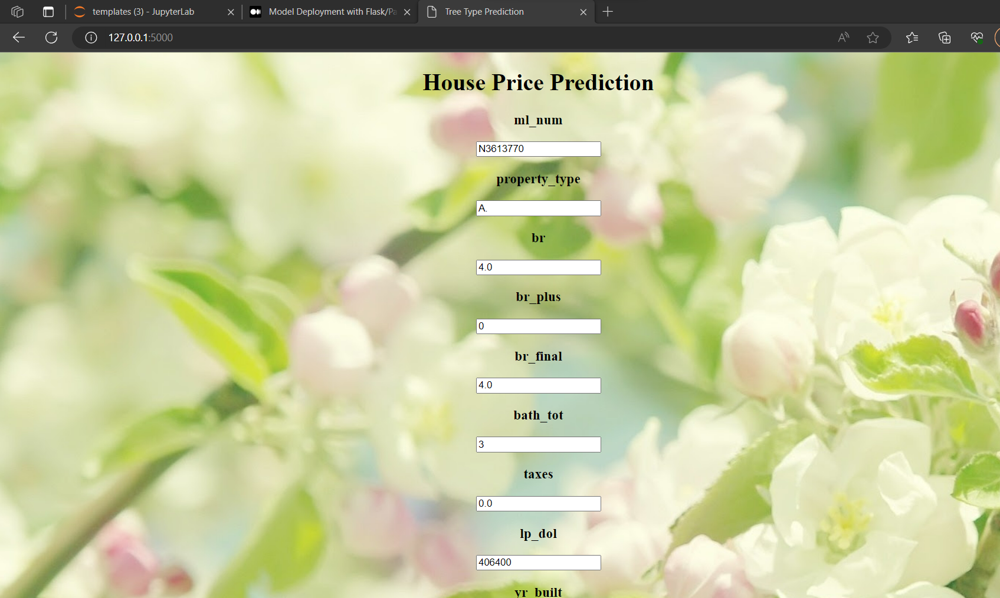

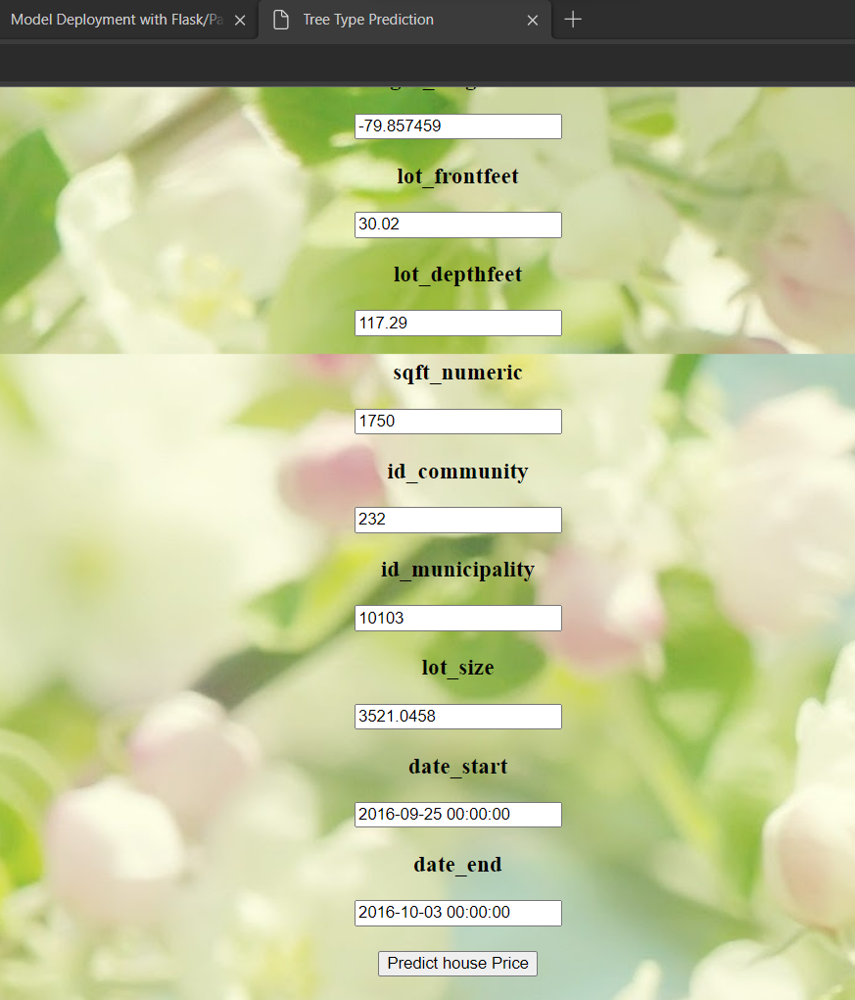

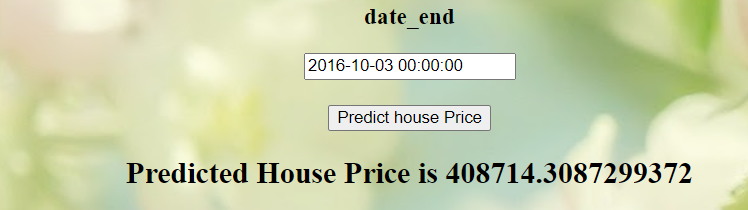